In [1]:
import geopandas as gpd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt


# Оценка стоимости кварталов

In [2]:
blocks_gdf = gpd.read_parquet('/Users/mvin/Code/blocksnet/examples/data/blocks_maks.parquet')
blocks_gdf.columns

Index(['geometry', 'land_use', 'is_living', 'build_floor_area',
       'living_demand', 'living_area', 'share_living', 'business_area',
       'share_business', 'site_area', 'population', 'footprint_area', 'fsi',
       'gsi', 'l', 'osr', 'mxi', 'capacity_convenience', 'capacity_cafe',
       'capacity_mall', 'capacity_pharmacy', 'capacity_bank', 'capacity_fuel',
       'capacity_pitch', 'capacity_playground', 'capacity_museum',
       'capacity_parking', 'capacity_bakery', 'capacity_restaurant',
       'capacity_dog_park', 'capacity_university', 'capacity_police',
       'capacity_bar', 'capacity_park', 'capacity_government',
       'capacity_supermarket', 'capacity_kindergarten', 'capacity_polyclinic',
       'capacity_school', 'capacity_religion', 'capacity_post',
       'capacity_hairdresser', 'capacity_theatre', 'capacity_stadium',
       'capacity_cemetery', 'capacity_substation', 'capacity_hotel',
       'capacity_hospital', 'capacity_multifunctional_center',
       'capacity_sw

In [3]:
# from blocksnet.analysis.morphotypes import get_strelka_morphotypes

# blocks_df = get_strelka_morphotypes(blocks_gdf)
# blocks_gdf = blocks_gdf.join(blocks_df[['morphotype']], how='left')
# blocks_df.head()

In [4]:
# cadastr_land = gpd.read_parquet('data/spb_land_cad.parquet')
cadastr_blocks = gpd.read_parquet('/Users/mvin/Code/blocksnet/examples/data/spb_bloks_price.parquet')
cadastr_blocks.head()

,cadastralDistrictsCode,readable_address,cost_value,cost_index,land_record_category_type,permitted_use_established_by_document,specified_area,geometry
0,78,"Санкт-Петербург, город Зеленогорск, Решетников...",10833260.98,5846.3362,Земли населенных пунктов,для размещения индивидуального жилого дома (ин...,1852.0,"POLYGON ((3306132.351 8453357.197, 3306131.265..."
1,78,"г.Санкт-Петербург, город Зеленогорск, Решетник...",6533139.72,5444.2831,Земли населенных пунктов,для размещения индивидуального жилого дома (ин...,1200.0,"POLYGON ((3306613.198 8453876.707, 3306609.831..."
2,78,"Санкт-Петербург, город Зеленогорск, Красавица,...",16395.97,1366.3305,Земли населенных пунктов,Для размещения объектов коммунального хозяйства,12.0,"POLYGON ((3311932.709 8453466.264, 3311927.608..."
3,78,"Санкт-Петербург, город Зеленогорск, Решетников...",8425371.37,5513.9865,Земли населенных пунктов,Для размещения индивидуального (одноквартирног...,1528.0,"POLYGON ((3306341.721 8454345.055, 3306347.49 ..."
4,78,"Санкт-Петербург, город Зеленогорск, Решетников...",11430710.60,5715.3553,Земли населенных пунктов,для размещения индивидуального жилого дома (ин...,2000.0,"POLYGON ((3306583.407 8453412.704, 3306580.412..."


In [5]:
cadastr_blocks['log_cost_index'] = np.log1p(cadastr_blocks['cost_index'])

In [6]:
# blocks_gdf['log_population'] = np.log1p(blocks_gdf['population'])

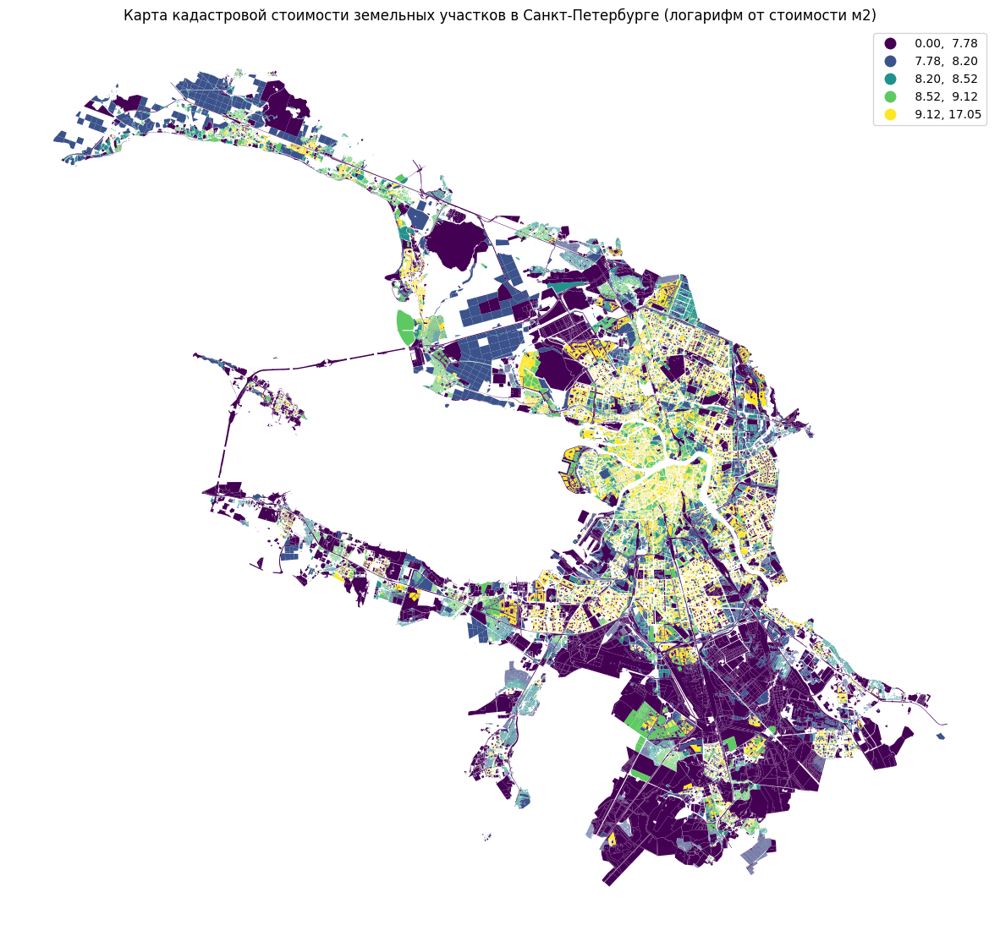

In [7]:
# Картируем лог-цену
cadastr_blocks.plot(
    column='log_cost_index',
    scheme='quantiles',
    legend=True,
    figsize=(15,15),
    cmap='viridis'
).set_axis_off()
plt.title('Карта кадастровой стоимости земельных участков в Санкт-Петербурге (логарифм от стоимости м2)')

plt.show()

In [8]:
import geopandas as gpd

# — 1. Клонируем оригиналы, чтобы не портить исходники
blocks = blocks_gdf.copy()
cad    = cadastr_blocks.copy()

# — 2. Приводим к единому CRS (он нужен для корректных площадей)
if blocks.crs != cad.crs:
    cad = cad.to_crs(blocks.crs)

# — 3. Считаем полную площадь cadastral-полигонов
cad['cad_area'] = cad.geometry.area

# — 4. Явно добавляем в blocks колонку block_id из индекса
blocks['block_id'] = blocks.index

# — 5. Пересечение кварталов и кадастра
inter = gpd.overlay(
    blocks[['block_id', 'geometry']],
    cad   [['cost_value', 'cad_area', 'geometry']],
    how='intersection'
)

# — 6. Площадь каждого куска пересечения
inter['int_area'] = inter.geometry.area

# — 7. Вклады стоимости пропорционально площади
inter['cost_contrib'] = inter['cost_value'] * inter['int_area'] / inter['cad_area']

# — 8. Суммируем для каждого квартала
block_costs = (
    inter
    .groupby('block_id', as_index=False)['cost_contrib']
    .sum()
    .rename(columns={'cost_contrib':'total_cost_value'})
)

# — 9. Мерджим обратно в blocks, заполняем пропуски нулями
blocks = blocks.merge(block_costs, on='block_id', how='left')
blocks['total_cost_value'] = blocks['total_cost_value'].fillna(0)

# — 10. При желании убираем служебный block_id (или возвращаем исходный индекс)
blocks = blocks.drop(columns=['block_id'])
blocks


,geometry,land_use,is_living,build_floor_area,living_demand,living_area,share_living,business_area,share_business,site_area,...,capacity_bus_stop,capacity_pier,capacity_animal_shelter,capacity_prison,capacity_landfill,capacity_plant_nursery,capacity_greenhouse_complex,capacity_warehouse,capacity_machine_building_plant,total_cost_value
0,"POLYGON ((354918.622 6625258.829, 354901.464 6...",None,True,43840.686518,50.641057,30688.480678,2.199357,13152.205840,0.942581,8.044667e+05,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7.414402e+08
1,"POLYGON ((355412.142 6623378.149, 355411.7 662...",transport,True,10294.395525,53.114392,2177.690063,0.431105,8116.705462,1.606820,2.317313e+04,...,20.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.699018e+07
2,"POLYGON ((353934.329 6625429.433, 353923.453 6...",recreation,True,1173.871643,58.693582,821.710142,0.706252,352.161501,0.302679,3.630058e+05,...,40.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.995869e+08
3,"POLYGON ((355099.099 6623847.765, 355074.808 6...",residential,True,46303.954706,52.660044,30595.485797,2.760046,15708.468909,1.417075,1.964145e+05,...,80.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6.688507e+08
4,"POLYGON ((352766.168 6621954.748, 352744.412 6...",recreation,True,153749.574111,53.097680,106407.750936,2.352959,47341.823175,1.046854,1.781752e+06,...,60.0,50.0,0.0,0.0,0.0,30.0,0.0,0.0,0.0,9.278002e+08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16315,"POLYGON ((335210.252 6655823.328, 335105.217 6...",transport,False,0.000000,NaN,0.000000,NaN,0.000000,NaN,6.477731e+03,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8.546459e+06
16316,"POLYGON ((315582.435 6679561.357, 315523.467 6...",transport,False,0.000000,NaN,0.000000,NaN,0.000000,NaN,1.211677e+03,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.389149e+06
16317,"POLYGON ((316419.909 6679189.653, 316319.749 6...",transport,False,0.000000,NaN,0.000000,NaN,0.000000,NaN,1.835190e+04,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.103986e+07
16318,"POLYGON ((315709.232 6679519.841, 315748.877 6...",transport,False,0.000000,NaN,0.000000,NaN,0.000000,NaN,1.592307e+03,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.825529e+06


In [9]:
# 1. Если CRS географический (deg), переведём в метрический (например, Меркатор)
if blocks.crs.is_geographic:
    blocks = blocks.to_crs(epsg=3857)

# 2. Считаем площадь каждого квартала в м²
blocks['area_sqm'] = blocks.geometry.area

# 3. Считаем цену за квадратный метр
blocks['price_per_sqm'] = blocks['total_cost_value'] / blocks['area_sqm']
blocks = blocks.drop(columns=['area_sqm'])
# 4. (Опционально) уберём бесконечные и NaN
blocks.loc[~blocks['price_per_sqm'].replace([np.inf, -np.inf], np.nan).notna(), 'price_per_sqm'] = 0
blocks = blocks.to_crs(epsg=32636)
blocks.head()
# Результат: в blocks['price_per_sqm'] — стоимость одного квадрата метра для каждого квартала


,geometry,land_use,is_living,build_floor_area,living_demand,living_area,share_living,business_area,share_business,site_area,...,capacity_pier,capacity_animal_shelter,capacity_prison,capacity_landfill,capacity_plant_nursery,capacity_greenhouse_complex,capacity_warehouse,capacity_machine_building_plant,total_cost_value,price_per_sqm
0,"POLYGON ((354918.622 6625258.829, 354901.464 6...",None,True,43840.686518,50.641057,30688.480678,2.199357,13152.205840,0.942581,8.044667e+05,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7.414402e+08,921.654306
1,"POLYGON ((355412.142 6623378.149, 355411.7 662...",transport,True,10294.395525,53.114392,2177.690063,0.431105,8116.705462,1.606820,2.317313e+04,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.699018e+07,1164.718608
2,"POLYGON ((353934.329 6625429.433, 353923.453 6...",recreation,True,1173.871643,58.693582,821.710142,0.706252,352.161501,0.302679,3.630058e+05,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.995869e+08,825.295138
3,"POLYGON ((355099.099 6623847.765, 355074.808 6...",residential,True,46303.954706,52.660044,30595.485797,2.760046,15708.468909,1.417075,1.964145e+05,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6.688507e+08,3405.302611
4,"POLYGON ((352766.168 6621954.748, 352744.412 6...",recreation,True,153749.574111,53.097680,106407.750936,2.352959,47341.823175,1.046854,1.781752e+06,...,50.0,0.0,0.0,0.0,30.0,0.0,0.0,0.0,9.278002e+08,520.723685


In [10]:
blocks['log_total_price'] = np.log1p(blocks['total_cost_value'])
blocks['log_price'] = np.log1p(blocks['price_per_sqm'])

count    16320.000000
mean        10.941086
std          8.642160
min          0.000000
25%          0.000000
50%         14.701470
75%         18.558323
max         24.163684
Name: log_total_price, dtype: float64


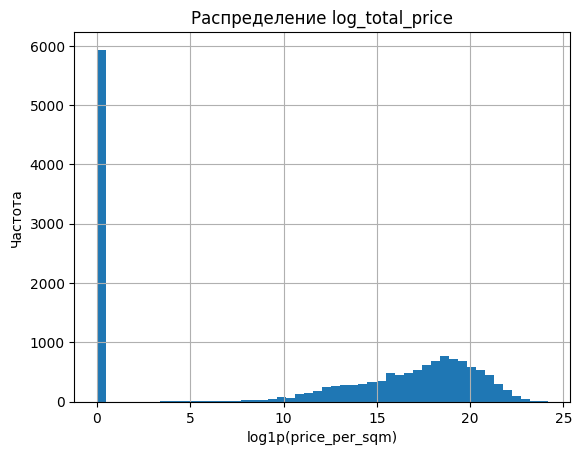

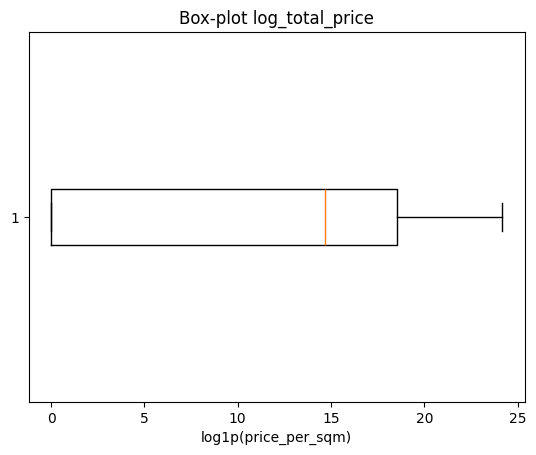

In [11]:
# Быстрая статистика
print(blocks['log_total_price'].describe())

# Гистограмма
plt.figure()
blocks['log_total_price'].hist(bins=50)
plt.xlabel('log1p(price_per_sqm)')
plt.ylabel('Частота')
plt.title('Распределение log_total_price')
plt.show()

# Box-plot
plt.figure()
plt.boxplot(blocks['log_total_price'].dropna(), vert=False)
plt.xlabel('log1p(price_per_sqm)')
plt.title('Box-plot log_total_price')
plt.show()


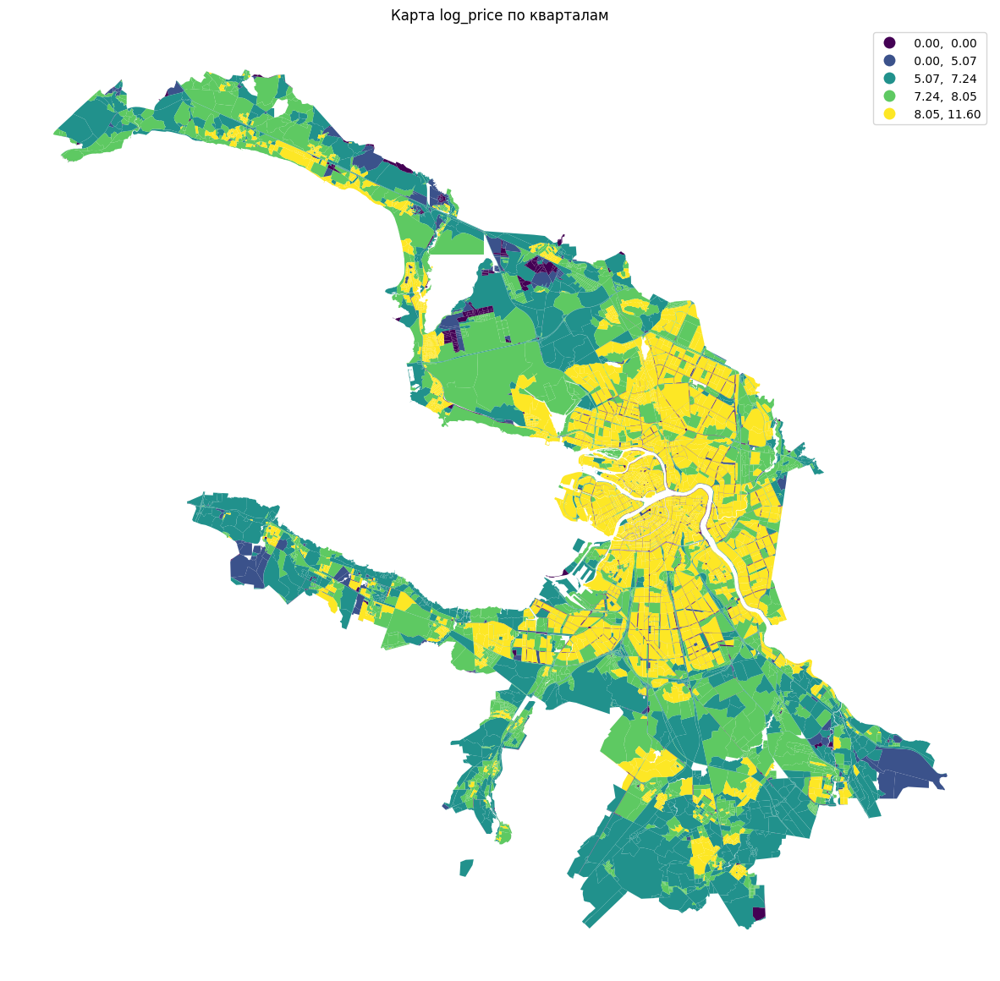

In [12]:
# Картируем лог-цену
blocks.plot(
    column='log_price',
    scheme='quantiles',
    legend=True,
    figsize=(15,15),
    cmap='viridis'
).set_axis_off()
plt.title('Карта log_price по кварталам')

plt.show()



In [13]:
# from sklearn.preprocessing import StandardScaler

# scaler = StandardScaler()
# blocks['log_std'] = scaler.fit_transform(
#     blocks[['log_price']]
# )

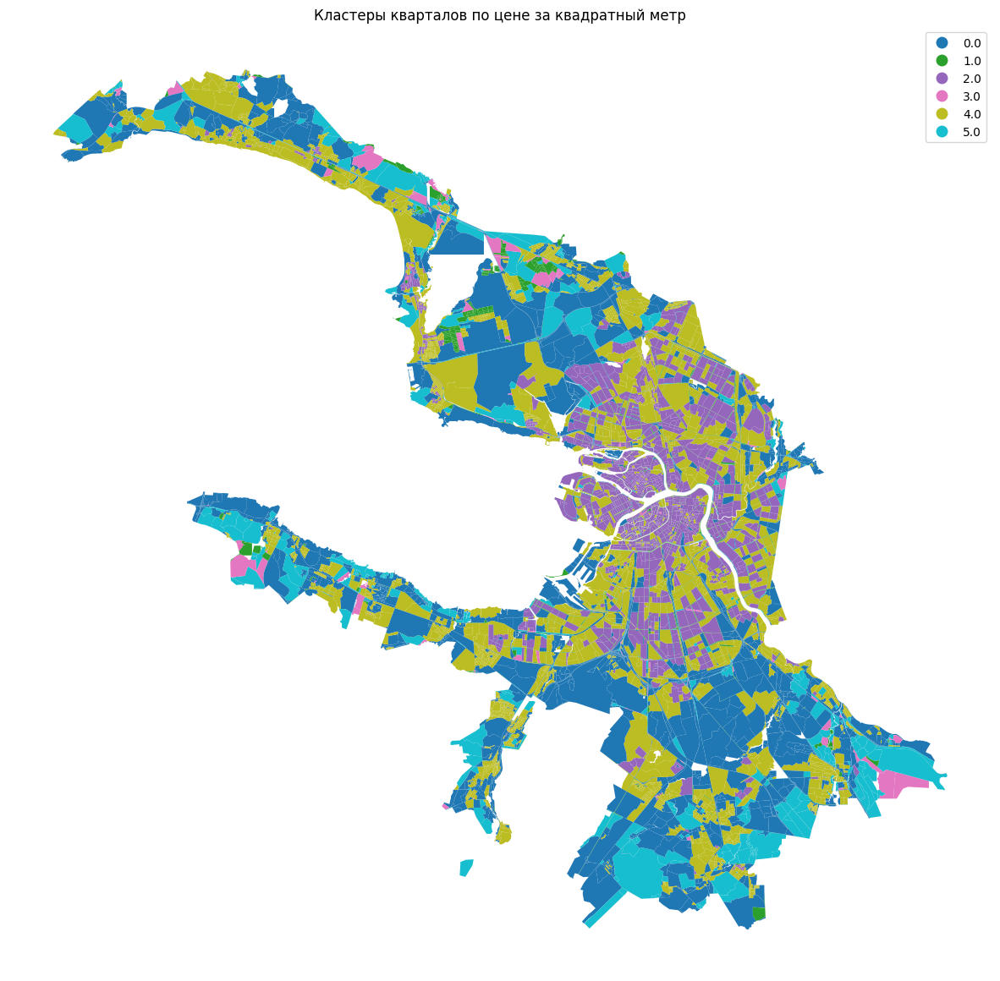

In [14]:
from sklearn.cluster import KMeans

# Берём только ненулевые и не NaN
X = blocks[['log_price']].dropna()

kmeans = KMeans(n_clusters=6, random_state=0)
blocks.loc[X.index, 'cluster'] = kmeans.fit_predict(X)

# Визуализируем
blocks.plot(
    column='cluster',
    categorical=True,
    legend=True,
    figsize=(15,15)
).set_axis_off()
plt.title('Кластеры кварталов по цене за квадратный метр')
plt.show()


In [15]:
# Собираем все имена колонок, которые начинаются на 'capacity'
cols_to_drop = [col for col in blocks.columns if col.startswith('capacity')]

# Удаляем их сразу все
blocks = blocks.drop(columns=cols_to_drop)
blocks.columns

Index(['geometry', 'land_use', 'is_living', 'build_floor_area',
       'living_demand', 'living_area', 'share_living', 'business_area',
       'share_business', 'site_area', 'population', 'footprint_area', 'fsi',
       'gsi', 'l', 'osr', 'mxi', 'total_cost_value', 'price_per_sqm',
       'log_total_price', 'log_price', 'cluster'],
      dtype='object')

## Дополнитльные метрики

In [16]:
from blocksnet.relations import generate_adjacency_graph

adjacency_graph = generate_adjacency_graph(blocks)

2025-06-30 17:35:37.511 | INFO     | blocksnet.relations.adjacency.core:_generate_adjacency_nodes:10 - Generating nodes
2025-06-30 17:35:37.516 | INFO     | blocksnet.relations.adjacency.core:_generate_adjacency_edges:15 - Generating edges
2025-06-30 17:35:39.833 | SUCCESS  | blocksnet.relations.adjacency.core:generate_adjacency_graph:38 - Adjacency graph successfully generated: 16320 nodes, 53425 edges


In [17]:
from blocksnet.analysis.centrality import population_centrality

centrality_df = population_centrality(blocks_gdf, adjacency_graph)
centrality_df.head()

,population,degree_centrality,population_normalized,degree_centrality_normalized,population_centrality
0,606,0.000429,1.019320,1.162791,0.091114
1,41,0.000613,1.001307,1.232558,0.115171
2,14,0.000490,1.000446,1.186047,0.091764
3,581,0.000490,1.018523,1.186047,0.102308
4,2004,0.000980,1.063889,1.372093,0.226121


In [18]:
df_to_merge = centrality_df.drop(columns=['population'])

In [19]:
blocks = blocks.join(df_to_merge)

In [20]:
import pandas as pd

accessibility_matrix = pd.read_pickle('/Users/mvin/Code/blocksnet/examples/data/accessibility_matrix.pickle')
accessibility_matrix.head()

/Users/mvin/Code/blocksnet/.venv/lib/python3.10/site-packages/pandas/io/formats/format.py:1458: RuntimeWarning: overflow encountered in cast
  has_large_values = (abs_vals > 1e6).any()


,0,1,2,3,4,5,6,7,8,9,...,16310,16311,16312,16313,16314,16315,16316,16317,16318,16319
0,0.000000,18.718750,9.234375,17.21875,30.296875,27.390625,30.671875,23.281250,78.6875,81.2500,...,76.5625,102.5625,97.5000,132.250,130.8750,142.125,247.625,228.625,247.625,124.6250
1,17.859375,0.000000,19.015625,7.65625,20.281250,25.250000,25.234375,15.765625,76.8750,79.4375,...,74.6875,100.7500,95.6875,130.500,129.0000,140.250,245.875,226.875,245.875,112.5000
2,9.234375,20.796875,0.000000,20.21875,27.968750,25.062500,28.343750,20.953125,71.8750,74.4375,...,69.7500,95.8125,90.6875,125.500,124.0625,135.375,240.875,221.875,240.875,124.6250
3,15.937500,7.449219,18.421875,0.00000,21.109375,24.984375,27.781250,16.593750,76.3125,78.8125,...,74.1250,100.1875,95.0625,129.875,128.5000,139.750,245.250,226.250,245.250,113.3750
4,31.906250,19.765625,31.734375,21.28125,0.000000,21.781250,23.125000,15.429688,89.5625,92.1250,...,87.4375,113.5000,108.3750,143.125,141.7500,153.000,258.500,239.500,258.500,108.3125


In [21]:
from blocksnet.analysis.accessibility import area_accessibility

area_acc_df = area_accessibility(accessibility_matrix, blocks_gdf)
area_acc_df

,area_accessibility
0,113.515315
1,109.100728
2,108.464070
3,109.170690
4,119.413257
...,...
16315,126.334338
16316,198.099430
16317,186.754339
16318,198.099430


In [22]:
blocks= blocks.join(area_acc_df)


In [23]:
blocks

,geometry,land_use,is_living,build_floor_area,living_demand,living_area,share_living,business_area,share_business,site_area,...,total_cost_value,price_per_sqm,log_total_price,log_price,cluster,degree_centrality,population_normalized,degree_centrality_normalized,population_centrality,area_accessibility
0,"POLYGON ((354918.622 6625258.829, 354901.464 6...",None,True,43840.686518,50.641057,30688.480678,2.199357,13152.205840,0.942581,8.044667e+05,...,7.414402e+08,921.654306,20.424105,6.827255,0.0,0.000429,1.019320,1.162791,0.091114,113.515315
1,"POLYGON ((355412.142 6623378.149, 355411.7 662...",transport,True,10294.395525,53.114392,2177.690063,0.431105,8116.705462,1.606820,2.317313e+04,...,2.699018e+07,1164.718608,17.110984,7.061093,0.0,0.000613,1.001307,1.232558,0.115171,109.100728
2,"POLYGON ((353934.329 6625429.433, 353923.453 6...",recreation,True,1173.871643,58.693582,821.710142,0.706252,352.161501,0.302679,3.630058e+05,...,2.995869e+08,825.295138,19.517915,6.716952,0.0,0.000490,1.000446,1.186047,0.091764,108.464070
3,"POLYGON ((355099.099 6623847.765, 355074.808 6...",residential,True,46303.954706,52.660044,30595.485797,2.760046,15708.468909,1.417075,1.964145e+05,...,6.688507e+08,3405.302611,20.321071,8.133383,4.0,0.000490,1.018523,1.186047,0.102308,109.170690
4,"POLYGON ((352766.168 6621954.748, 352744.412 6...",recreation,True,153749.574111,53.097680,106407.750936,2.352959,47341.823175,1.046854,1.781752e+06,...,9.278002e+08,520.723685,20.648327,6.257138,5.0,0.000980,1.063889,1.372093,0.226121,119.413257
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16315,"POLYGON ((335210.252 6655823.328, 335105.217 6...",transport,False,0.000000,NaN,0.000000,NaN,0.000000,NaN,6.477731e+03,...,8.546459e+06,1319.359921,15.961028,7.185660,0.0,0.000123,1.000000,1.046512,0.022876,126.334338
16316,"POLYGON ((315582.435 6679561.357, 315523.467 6...",transport,False,0.000000,NaN,0.000000,NaN,0.000000,NaN,1.211677e+03,...,1.389149e+06,1146.468062,14.144203,7.045313,0.0,0.000245,1.000000,1.093023,0.045752,198.099430
16317,"POLYGON ((316419.909 6679189.653, 316319.749 6...",transport,False,0.000000,NaN,0.000000,NaN,0.000000,NaN,1.835190e+04,...,2.103986e+07,1146.468062,16.861930,7.045313,0.0,0.000306,1.000000,1.116279,0.057189,186.754339
16318,"POLYGON ((315709.232 6679519.841, 315748.877 6...",transport,False,0.000000,NaN,0.000000,NaN,0.000000,NaN,1.592307e+03,...,1.825529e+06,1146.468062,14.417381,7.045313,0.0,0.000245,1.000000,1.093023,0.045752,198.099430


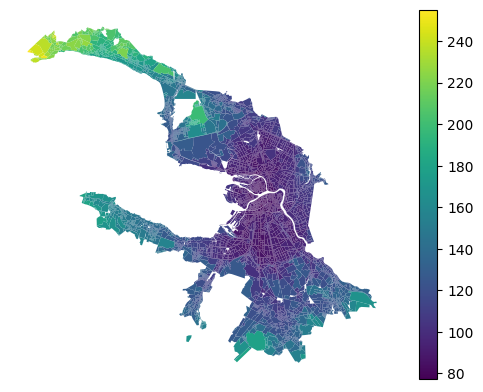

In [24]:
blocks.plot(column='area_accessibility', legend=True).set_axis_off()

In [25]:
blocks.columns

Index(['geometry', 'land_use', 'is_living', 'build_floor_area',
       'living_demand', 'living_area', 'share_living', 'business_area',
       'share_business', 'site_area', 'population', 'footprint_area', 'fsi',
       'gsi', 'l', 'osr', 'mxi', 'total_cost_value', 'price_per_sqm',
       'log_total_price', 'log_price', 'cluster', 'degree_centrality',
       'population_normalized', 'degree_centrality_normalized',
       'population_centrality', 'area_accessibility'],
      dtype='object')

In [26]:
# 1. Выведем все dtypes
print(blocks.dtypes)

# 2. Отберём «чисто» категориальные (object / category)
cat_cols = blocks.select_dtypes(include=['object','category']).columns.tolist()
print("Категориальные по dtype:", cat_cols)

# 3. Часто к категориальным относят и числовые колонки с малым числом уникальных значений.
#    Например, если уникальных значений меньше 10:
low_cardinality = [
    col for col in blocks.select_dtypes(include=['int64','float64']).columns
    if blocks[col].nunique() < 10
]
print("Возможно категориальные по низкой кардинальности:", low_cardinality)


geometry                        geometry
land_use                          object
is_living                           bool
build_floor_area                 float64
living_demand                    float64
living_area                      float64
share_living                     float64
business_area                    float64
share_business                   float64
site_area                        float64
population                         int64
footprint_area                   float64
fsi                              float64
gsi                              float64
l                                float64
osr                              float64
mxi                              float64
total_cost_value                 float64
price_per_sqm                    float64
log_total_price                  float64
log_price                        float64
cluster                          float64
degree_centrality                float64
population_normalized            float64
degree_centralit

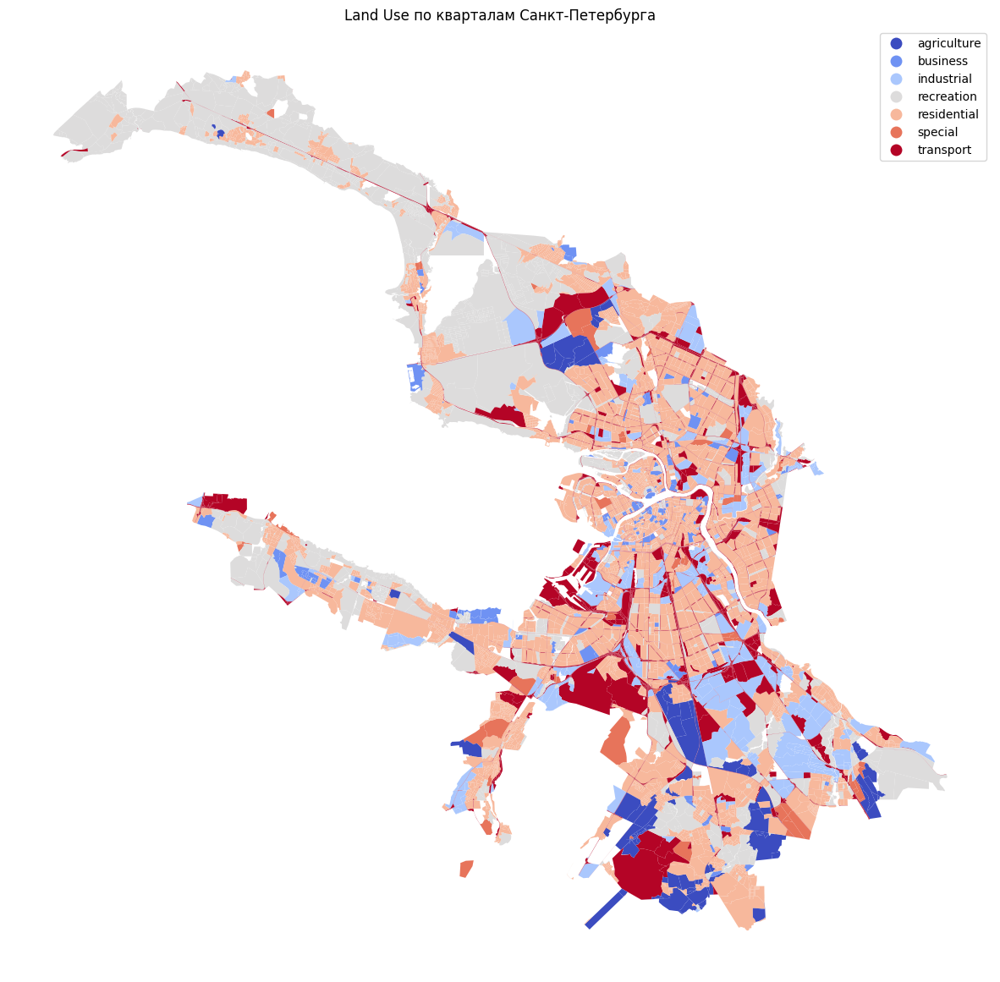

In [27]:
# Картируем лог-цену
blocks.plot(
    column='land_use',
    legend=True,
    figsize=(15,15),
    cmap='coolwarm'
).set_axis_off()
plt.title('Land Use по кварталам Санкт-Петербурга')

plt.show()

In [28]:
import pandas as pd

# 1. Отбираем числовые столбцы и фильтруем
num = blocks.select_dtypes(include=['number'])
num = num[num['log_price'] > 1]

# 2. Считаем count + статистики
agg_stats = num.agg(['count', 'min', 'max', 'mean', 'median', 'std']).T

# 3. Переименовываем столбцы
agg_stats.index.name = 'Variable'
agg_stats = agg_stats.rename(columns={
    'count':  'Count',
    'min':    'Min',
    'max':    'Max',
    'mean':   'Mean',
    'median': 'Median',
    'std':    'SD'
})

# 4. Приводим Count к int
agg_stats['Count'] = agg_stats['Count'].astype(int)

# 5. Округляем остальные метрики
for col in ['Min','Max','Mean','Median','SD']:
    agg_stats[col] = agg_stats[col].round(2)

# 6. Настраиваем глобальный формат для float
pd.options.display.float_format = '{:,.2f}'.format

# 7. Показываем результат
agg_stats


,Count,Min,Max,Mean,Median,SD
Variable,,,,,,
build_floor_area,10303,0.00,"1,659,527.76","38,306.64",878.68,"106,895.10"
living_demand,4548,0.00,561.19,43.76,32.66,31.90
living_area,10303,0.00,"658,793.14","16,413.36",0.00,"55,527.78"
share_living,6013,0.00,21.02,1.22,0.70,1.70
business_area,10303,0.00,"1,659,527.76","21,893.28",446.53,"63,030.60"
share_business,6013,0.11,65.22,1.54,1.01,1.63
site_area,10303,1.07,"16,147,809.90","129,144.01","21,660.70","457,248.04"
population,10303,0.00,"31,367.00",524.37,0.00,"1,929.06"
footprint_area,10303,0.00,"757,715.64","9,991.32",755.65,"25,029.45"


# CatBoost

/var/folders/h8/0wmx2zx90bn60jw8zc1r4qjc0000gn/T/ipykernel_6618/1098382770.py:27: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  w1 = Queen.from_dataframe(blocks)      # w1.weights — все 1
/Users/mvin/Code/blocksnet/.venv/lib/python3.10/site-packages/libpysal/weights/contiguity.py:347: UserWarning: The weights matrix is not fully connected: 
 There are 92 disconnected components.
 There are 56 islands with ids: 15773, 15774, 15775, 15776, 15777, 15778, 15784, 15785, 15800, 15801, 15802, 15803, 15804, 15805, 15821, 15823, 15895, 15899, 15900, 15901, 15902, 15903, 15904, 15905, 15906, 15907, 15908, 15909, 15934, 15935, 15936, 15982, 16001, 16002, 16003, 16004, 16005, 16006, 16007, 16008, 16010, 16011, 16012, 16013, 16147, 16148, 16149, 16150, 16151, 16152, 16153, 16154, 16155, 16156, 16157, 16319.
  W.__init__(self, neighbors, ids=ids, **kw)
/Users/mvin/Code/blocksnet/.venv/lib/p

('WARNING: ', 15773, ' is an island (no neighbors)')
('WARNING: ', 15774, ' is an island (no neighbors)')
('WARNING: ', 15775, ' is an island (no neighbors)')
('WARNING: ', 15776, ' is an island (no neighbors)')
('WARNING: ', 15777, ' is an island (no neighbors)')
('WARNING: ', 15778, ' is an island (no neighbors)')
('WARNING: ', 15784, ' is an island (no neighbors)')
('WARNING: ', 15785, ' is an island (no neighbors)')
('WARNING: ', 15800, ' is an island (no neighbors)')
('WARNING: ', 15801, ' is an island (no neighbors)')
('WARNING: ', 15802, ' is an island (no neighbors)')
('WARNING: ', 15803, ' is an island (no neighbors)')
('WARNING: ', 15804, ' is an island (no neighbors)')
('WARNING: ', 15805, ' is an island (no neighbors)')
('WARNING: ', 15821, ' is an island (no neighbors)')
('WARNING: ', 15823, ' is an island (no neighbors)')
('WARNING: ', 15895, ' is an island (no neighbors)')
('WARNING: ', 15899, ' is an island (no neighbors)')
('WARNING: ', 15900, ' is an island (no neighb

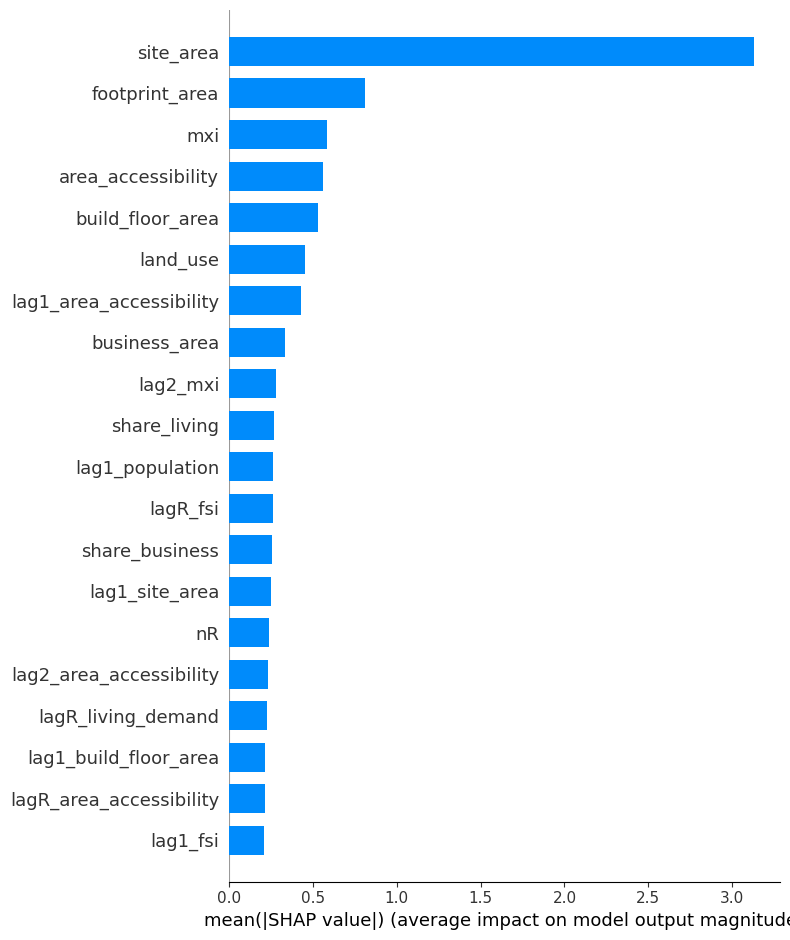

<Figure size 640x480 with 0 Axes>

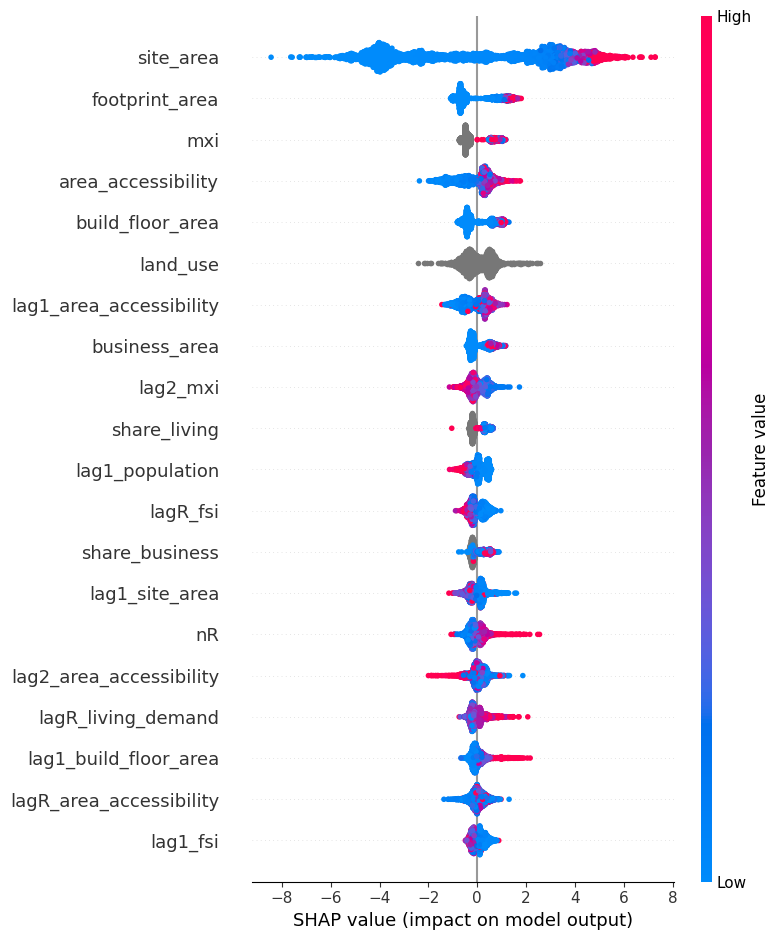

<Figure size 640x480 with 0 Axes>

In [29]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
from catboost import CatBoostRegressor, Pool
import shap, matplotlib.pyplot as plt
from libpysal.weights import Queen, higher_order, DistanceBand
from libpysal.weights import Queen, higher_order, DistanceBand, lag_spatial

# --- 0. Исходные данные ---
# blocks — GeoDataFrame с колонкой log_total_price

feature_cols = [
    'land_use', 'is_living',
    'build_floor_area', 'living_demand', 'living_area', 'share_living',
    'business_area', 'share_business', 'site_area', 'population',
    'footprint_area', 'fsi', 'gsi', 'l', 'osr', 'mxi',
    'area_accessibility', 'degree_centrality',
    'population_normalized', 'degree_centrality_normalized',
    'population_centrality'
]

cat_feats     = ['land_use','is_living']
numeric_feats = [c for c in feature_cols if c not in cat_feats]
# --- 1. Матрицы соседства ---
# 1) Сырые (бинарные) матрицы
w1 = Queen.from_dataframe(blocks)      # w1.weights — все 1
w2 = higher_order(w1, k=2)             # второй уровень соседей

# 2) Радиальный тоже сразу строим
R  = 500
wR = DistanceBand.from_dataframe(
    blocks, threshold=R, binary=True, silence_warnings=True
)

# 3) Теперь нормализуем строки
w1.transform = 'r'
w2.transform = 'r'
wR.transform = 'r'

# --- 2. Генерация лаг-фичей трёх типов ---
lag_cols = []
for feat in numeric_feats:
    vec = blocks[feat].fillna(blocks[feat].mean())

    # лаг-среднее первого порядка
    blocks[f'lag1_{feat}'] = lag_spatial(w1, vec)
    lag_cols.append(f'lag1_{feat}')

    # лаг-среднее второго порядка
    blocks[f'lag2_{feat}'] = lag_spatial(w2, vec)
    lag_cols.append(f'lag2_{feat}')

    # лаг-среднее в радиусе R
    blocks[f'lagR_{feat}'] = lag_spatial(wR, vec)
    lag_cols.append(f'lagR_{feat}')

# (опционально) число соседей каждого вида
blocks['n1'] = pd.Series({i: len(nb) for i,nb in w1.neighbors.items()})
blocks['n2'] = pd.Series({i: len(nb) for i,nb in w2.neighbors.items()})
blocks['nR'] = pd.Series({i: len(nb) for i,nb in wR.neighbors.items()})
lag_cols += ['n1','n2','nR']

# --- 3. Собираем финальный список фичей и split ---
all_feats = feature_cols + lag_cols
X = blocks[all_feats]
y = blocks['log_total_price']

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# --- 5. Предобработка категорий ---
cat_features = ['land_use', 'is_living']
for df in (X_train, X_test):
    df['land_use'] = df['land_use'].fillna('missing')\
                                 .astype(str).astype('category')
    df['is_living'] = df['is_living'].fillna(False)\
                                     .astype('bool').astype('category')

cat_feature_indices = [X_train.columns.get_loc(c) for c in cat_features]

# --- 6. Pool для CatBoost ---
train_pool = Pool(data=X_train, label=y_train, cat_features=cat_feature_indices)
test_pool  = Pool(data=X_test,  label=y_test,  cat_features=cat_feature_indices)

# --- 7. Обучение модели ---
model = CatBoostRegressor(
    iterations=8000,
    learning_rate=0.05,
    depth=5,
    eval_metric='RMSE',
    random_seed=42,
    verbose=100
)
model.fit(train_pool, eval_set=test_pool, early_stopping_rounds=100)

# --- 8. Оценка на тесте ---
y_pred = model.predict(X_test)
r2   = r2_score(y_test, y_pred)
mae  = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))

print(f"R²   = {r2:.4f}")
print(f"MAE  = {mae:.4f}")
print(f"RMSE = {rmse:.4f}")

# --- 9. SHAP-анализ ---
explainer   = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test)

# 9.1: глобальная важность (bar plot)
shap.summary_plot(shap_values, X_test, plot_type="bar")
plt.tight_layout()
plt.show()

# 9.2: Beeswarm-plot
shap.summary_plot(shap_values, X_test)
plt.tight_layout()
plt.show()


Δ log_total_price:
 • 5891 (target): 20.355 → 19.694  (Δ -0.660)
 • 5874 (1st-order): 20.204 → 19.030  (Δ -1.174)
 • 5875 (1st-order): 12.028 → 7.849  (Δ -4.179)
 • 5893 (1st-order): 20.845 → 19.814  (Δ -1.031)
 • 5894 (1st-order): 17.486 → 17.990  (Δ +0.504)
 • 7259 (1st-order): 0.000 → -0.850  (Δ -0.850)
 • 7260 (1st-order): 0.000 → -0.833  (Δ -0.833)
 • 7261 (1st-order): 0.000 → -0.828  (Δ -0.828)
 • 5865 (2nd-order): 0.000 → -1.467  (Δ -1.467)
 • 5878 (2nd-order): 0.000 → -0.004  (Δ -0.004)
 • 5879 (2nd-order): 0.000 → 0.626  (Δ +0.626)
 • 5892 (2nd-order): 0.000 → 0.536  (Δ +0.536)
 • 6013 (2nd-order): 20.406 → 19.974  (Δ -0.432)
 • 6014 (2nd-order): 21.118 → 20.734  (Δ -0.384)
 • 6021 (2nd-order): 0.000 → 2.401  (Δ +2.401)
 • 7282 (2nd-order): 0.000 → 1.053  (Δ +1.053)
 • 7958 (2nd-order): 0.000 → -0.633  (Δ -0.633)
 • 1337 (radial): 20.641 → 21.076  (Δ +0.435)
 • 2702 (radial): 0.000 → 1.262  (Δ +1.262)
 • 3195 (radial): 21.147 → 20.232  (Δ -0.914)
 • 3196 (radial): 0.000 → 1.42

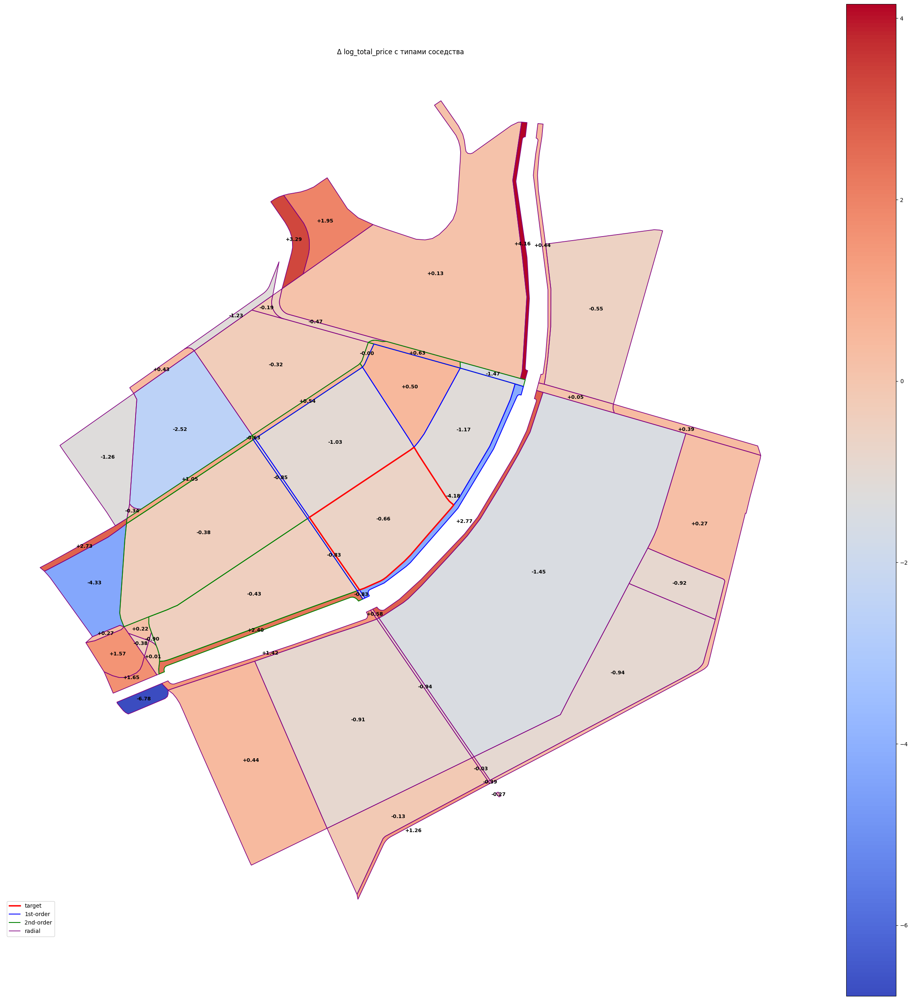

In [32]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from libpysal.weights import lag_spatial
from matplotlib.lines import Line2D

def plot_scenario_with_types_highlight_target(
    blocks, w1, w2, wR, model,
    orig_feats, numeric_feats,
    target_idx, changes
):
    """
    Визуализация Δ log_total_price для target и соседей,
    с разметкой по типу соседства и явным выделением target.
    """
    # 1) Применяем «что-если» к target
    blocks_scn = blocks.copy()
    for feat, newval in changes.items():
        blocks_scn.at[target_idx, feat] = newval

    # 2) Генерируем lag1/lag2/lagR и n1/n2/nR
    lag_cols = []
    gm = blocks[numeric_feats].mean()
    for feat in numeric_feats:
        vec = blocks_scn[feat].fillna(gm[feat])
        for prefix, w in (('lag1', w1), ('lag2', w2), ('lagR', wR)):
            col = f'{prefix}_{feat}'
            blocks_scn[col] = lag_spatial(w, vec)
            lag_cols.append(col)
    blocks_scn['n1'] = pd.Series({i: len(nb) for i,nb in w1.neighbors.items()})
    blocks_scn['n2'] = pd.Series({i: len(nb) for i,nb in w2.neighbors.items()})
    blocks_scn['nR'] = pd.Series({i: len(nb) for i,nb in wR.neighbors.items()})
    lag_cols += ['n1','n2','nR']

    # 3) Разбиваем индексы по типу
    ids1 = sorted(w1.neighbors[target_idx])
    ids2 = sorted(set(w2.neighbors[target_idx]) - set(ids1))
    idsR = sorted(set(wR.neighbors[target_idx]) - set(ids1) - set(w2.neighbors[target_idx]))
    idxs = [target_idx] + ids1 + ids2 + idsR

    # 4) Предсказываем «после»
    all_feats = orig_feats + lag_cols
    X_after = blocks_scn.loc[idxs, all_feats].copy()
    X_after['land_use']  = X_after['land_use'].fillna('missing').astype(str).astype('category')
    X_after['is_living'] = X_after['is_living'].fillna(False).astype('bool').astype('category')
    preds_after = model.predict(X_after)

    # 5) Собираем GeoDataFrame и считаем Δ
    gdf = blocks.loc[idxs].copy()
    gdf['pred_after'] = preds_after
    gdf['diff']       = gdf['pred_after'] - gdf['log_total_price']

    # 6) Текстовый отчёт
    def ntype(i):
        if i == target_idx: return 'target'
        if i in ids1:       return '1st-order'
        if i in ids2:       return '2nd-order'
        return 'radial'
    print("Δ log_total_price:")
    for i, r in gdf.iterrows():
        print(f" • {i} ({ntype(i)}): {r['log_total_price']:.3f} → {r['pred_after']:.3f}  (Δ {r['diff']:+.3f})")

    # 7) Рисуем
    fig, ax = plt.subplots(figsize=(25,25))

    # 7.1 Фон (заливка Δ)
    gdf.plot(
        ax=ax, column='diff', cmap='coolwarm', legend=True,
        edgecolor='none', zorder=1
    )

    # 7.2 Радиальные соседи
    for i in idsR:
        gdf.loc[[i]].boundary.plot(
            ax=ax, color='purple', linewidth=1.2, zorder=2
        )
    # 2nd-order
    for i in ids2:
        gdf.loc[[i]].boundary.plot(
            ax=ax, color='green', linewidth=1.5, zorder=3
        )
    # 1st-order
    for i in ids1:
        gdf.loc[[i]].boundary.plot(
            ax=ax, color='blue', linewidth=1.5, zorder=4
        )

    # 7.3 Таргет (последним, поверх всех)
    gdf.loc[[target_idx]].plot(
        ax=ax, facecolor='none', edgecolor='red', linewidth=2.5, zorder=5
    )

    ax.axis('off')
    ax.set_title('Δ log_total_price с типами соседства', pad=12)

    # 8) Легенда контуров
    legend_elems = [
        Line2D([0],[0], color='red',    lw=2.5, label='target'),
        Line2D([0],[0], color='blue',   lw=1.5, label='1st-order'),
        Line2D([0],[0], color='green',  lw=1.5, label='2nd-order'),
        Line2D([0],[0], color='purple', lw=1.2, label='radial'),
    ]
    ax.legend(handles=legend_elems, loc='lower left')

    # 9) Подписи Δ
    for i, r in gdf.iterrows():
        x, y = r.geometry.centroid.coords[0]
        ax.text(
            x, y, f"{r['diff']:+.2f}",
            ha='center', va='center',
            fontsize=9, fontweight='bold',
            zorder=6
        )

    plt.tight_layout()
    plt.show()



plot_scenario_with_types_highlight_target(
    blocks=blocks,
    w1=w1, w2=w2, wR=wR,
    model=model,
    orig_feats=feature_cols,
    numeric_feats=numeric_feats,
    target_idx=5891,
    changes={'living_area':1500, 'population':5000}
)


# CatBoost 2

/var/folders/h8/0wmx2zx90bn60jw8zc1r4qjc0000gn/T/ipykernel_6618/1621140400.py:29: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  w1 = Queen.from_dataframe(blocks_all)
/Users/mvin/Code/blocksnet/.venv/lib/python3.10/site-packages/libpysal/weights/contiguity.py:347: UserWarning: The weights matrix is not fully connected: 
 There are 92 disconnected components.
 There are 56 islands with ids: 15773, 15774, 15775, 15776, 15777, 15778, 15784, 15785, 15800, 15801, 15802, 15803, 15804, 15805, 15821, 15823, 15895, 15899, 15900, 15901, 15902, 15903, 15904, 15905, 15906, 15907, 15908, 15909, 15934, 15935, 15936, 15982, 16001, 16002, 16003, 16004, 16005, 16006, 16007, 16008, 16010, 16011, 16012, 16013, 16147, 16148, 16149, 16150, 16151, 16152, 16153, 16154, 16155, 16156, 16157, 16319.
  W.__init__(self, neighbors, ids=ids, **kw)
/Users/mvin/Code/blocksnet/.venv/lib/python3.10/site-package

('WARNING: ', 15773, ' is an island (no neighbors)')
('WARNING: ', 15774, ' is an island (no neighbors)')
('WARNING: ', 15775, ' is an island (no neighbors)')
('WARNING: ', 15776, ' is an island (no neighbors)')
('WARNING: ', 15777, ' is an island (no neighbors)')
('WARNING: ', 15778, ' is an island (no neighbors)')
('WARNING: ', 15784, ' is an island (no neighbors)')
('WARNING: ', 15785, ' is an island (no neighbors)')
('WARNING: ', 15800, ' is an island (no neighbors)')
('WARNING: ', 15801, ' is an island (no neighbors)')
('WARNING: ', 15802, ' is an island (no neighbors)')
('WARNING: ', 15803, ' is an island (no neighbors)')
('WARNING: ', 15804, ' is an island (no neighbors)')
('WARNING: ', 15805, ' is an island (no neighbors)')
('WARNING: ', 15821, ' is an island (no neighbors)')
('WARNING: ', 15823, ' is an island (no neighbors)')
('WARNING: ', 15895, ' is an island (no neighbors)')
('WARNING: ', 15899, ' is an island (no neighbors)')
('WARNING: ', 15900, ' is an island (no neighb

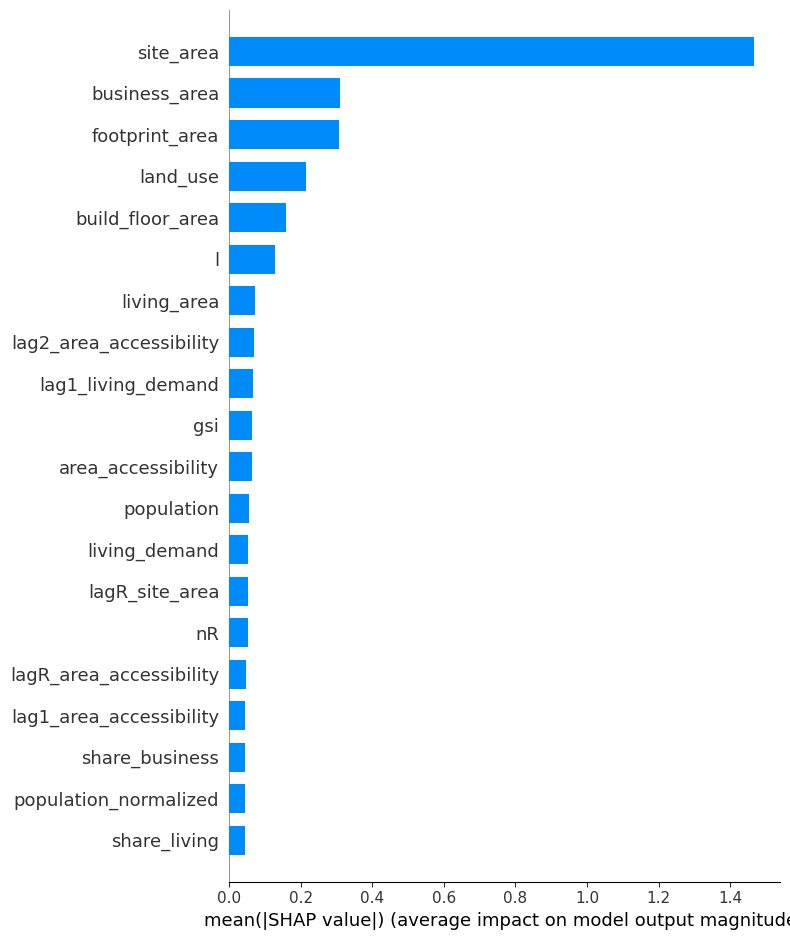

<Figure size 640x480 with 0 Axes>

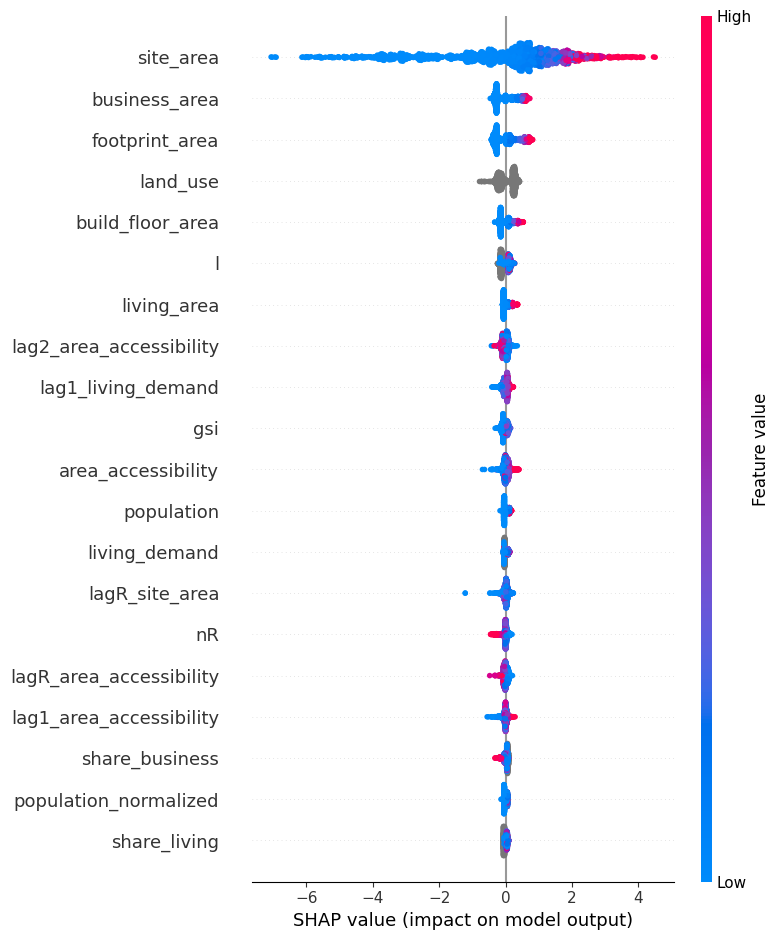

<Figure size 640x480 with 0 Axes>

In [33]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
from catboost import CatBoostRegressor, Pool
from libpysal.weights import Queen, higher_order, DistanceBand, lag_spatial
from matplotlib.lines import Line2D
import shap

# === 0. Исходные данные ===
# blocks_all: полный GeoDataFrame (и кварталы, и дороги)
blocks_all = blocks.copy()

feature_cols = [
    'land_use', 'is_living',
    'build_floor_area', 'living_demand', 'living_area', 'share_living',
    'business_area', 'share_business', 'site_area', 'population',
    'footprint_area', 'fsi', 'gsi', 'l', 'osr', 'mxi',
    'area_accessibility', 'degree_centrality',
    'population_normalized', 'degree_centrality_normalized',
    'population_centrality'
]
cat_feats     = ['land_use','is_living']
numeric_feats = [c for c in feature_cols if c not in cat_feats]

# === 1. Матрицы соседства на полном blocks_all ===
# 1-й порядок (Queen, бинарный → потом нормализуем)
w1 = Queen.from_dataframe(blocks_all)
# 2-й порядок
w2 = higher_order(w1, k=2)
# радиальный (500 м)
R  = 500
wR = DistanceBand.from_dataframe(
    blocks_all, threshold=R, binary=True, silence_warnings=True
)
# нормируем
for w in (w1, w2, wR):
    w.transform = 'r'

# === 2. Генерация lag-фичей и счётчиков соседей ===
for feat in numeric_feats:
    vec = blocks_all[feat].fillna(blocks_all[feat].mean())
    blocks_all[f'lag1_{feat}'] = lag_spatial(w1, vec)
    blocks_all[f'lag2_{feat}'] = lag_spatial(w2, vec)
    blocks_all[f'lagR_{feat}'] = lag_spatial(wR, vec)

blocks_all['n1'] = pd.Series({i: len(nb) for i,nb in w1.neighbors.items()})
blocks_all['n2'] = pd.Series({i: len(nb) for i,nb in w2.neighbors.items()})
blocks_all['nR'] = pd.Series({i: len(nb) for i,nb in wR.neighbors.items()})

# === 3. Фильтрация для обучения ===
# Желаем обучать только на кварталах (log_total_price > 0)
blocks = blocks_all[blocks_all['log_total_price'] > 0].copy()

lag_cols = (
    [f'lag1_{f}' for f in numeric_feats] +
    [f'lag2_{f}' for f in numeric_feats] +
    [f'lagR_{f}' for f in numeric_feats] +
    ['n1','n2','nR']
)
all_feats = feature_cols + lag_cols

X = blocks[all_feats]
y = blocks['log_total_price']

# === 4. Train/test split ===
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# === 5. Предобработка категорий ===
for df in (X_train, X_test):
    df['land_use']  = df['land_use'].fillna('missing').astype(str).astype('category')
    df['is_living'] = df['is_living'].fillna(False).astype('bool').astype('category')
cat_feature_indices = [X_train.columns.get_loc(c) for c in cat_feats]

# === 6. Pool и обучение CatBoost ===
train_pool = Pool(X_train, y_train, cat_features=cat_feature_indices)
test_pool  = Pool(X_test,  y_test,  cat_features=cat_feature_indices)

model = CatBoostRegressor(
    iterations=8000,
    learning_rate=0.05,
    depth=5,
    eval_metric='RMSE',
    random_seed=42,
    verbose=100
)
model.fit(train_pool, eval_set=test_pool, early_stopping_rounds=100)

# === 7. Оценка на тесте ===
y_pred = model.predict(X_test)
print(f"R²   = {r2_score(y_test, y_pred):.4f}")
print(f"MAE  = {mean_absolute_error(y_test, y_pred):.4f}")
print(f"RMSE = {np.sqrt(mean_squared_error(y_test, y_pred)):.4f}")

# === 8. SHAP-анализ ===
explainer   = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test)
shap.summary_plot(shap_values, X_test, plot_type="bar")
plt.tight_layout(); plt.show()
shap.summary_plot(shap_values, X_test)
plt.tight_layout(); plt.show()




In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import geopandas as gpd
from libpysal.weights import Queen, higher_order, DistanceBand, lag_spatial
from matplotlib.lines import Line2D

# === 0. Фильтрация и сброс индексов ===
# blocks_all — ваш исходный GeoDataFrame с кварталами и дорогами
blocks = blocks_all[blocks_all['log_total_price'] > 0].copy()
blocks = blocks.reset_index(drop=True)  # теперь индексы 0..N-1

# === 1. Списки фичей ===
feature_cols = [
    'land_use', 'is_living',
    'build_floor_area', 'living_demand', 'living_area', 'share_living',
    'business_area', 'share_business', 'site_area', 'population',
    'footprint_area', 'fsi', 'gsi', 'l', 'osr', 'mxi',
    'area_accessibility', 'degree_centrality',
    'population_normalized', 'degree_centrality_normalized',
    'population_centrality'
]
numeric_feats = [c for c in feature_cols if c not in ['land_use','is_living']]

# === 2. Строим матрицы соседства на blocks ===
w1 = Queen.from_dataframe(blocks)
w2 = higher_order(w1, k=2)
wR = DistanceBand.from_dataframe(
    blocks, threshold=500, binary=True, silence_warnings=True
)
for w in (w1, w2, wR):
    w.transform = 'r'

# === 3. (Предполагаем) у вас уже обучена модель на этих же blocks и w1,w2,wR ===
# model = CatBoostRegressor(...).fit(...)

# === 4. Функция визуализации ===
def plot_scenario_with_types_highlight_target(
    blocks, w1, w2, wR, model,
    orig_feats, numeric_feats,
    target_idx, changes
):
    # -- 1) «Что-если» --
    blocks_scn = blocks.copy()
    for feat, newval in changes.items():
        blocks_scn.at[target_idx, feat] = newval

    # -- 2) Lag-фичи и счётчики соседей --
    lag_cols = []
    means = blocks[numeric_feats].mean()
    for feat in numeric_feats:
        vec = blocks_scn[feat].fillna(means[feat])
        for prefix, w in (('lag1', w1), ('lag2', w2), ('lagR', wR)):
            col = f'{prefix}_{feat}'
            blocks_scn[col] = lag_spatial(w, vec)
            lag_cols.append(col)
    for name, w in [('n1', w1), ('n2', w2), ('nR', wR)]:
        blocks_scn[name] = pd.Series({i: len(neis) for i, neis in w.neighbors.items()})
    lag_cols += ['n1','n2','nR']

    # -- 3) Группируем соседей по типу --
    ids1 = sorted(w1.neighbors[target_idx])
    ids2 = sorted(set(w2.neighbors[target_idx]) - set(ids1))
    idsR = sorted(set(wR.neighbors[target_idx]) - set(ids1) - set(ids2))
    idxs = [target_idx] + ids1 + ids2 + idsR

    # -- 4) Предсказываем «после» --
    X_after = blocks_scn.loc[idxs, orig_feats + lag_cols].copy()
    X_after['land_use']  = X_after['land_use'].fillna('missing').astype('category')
    X_after['is_living'] = X_after['is_living'].fillna(False).astype('category')
    preds_after = model.predict(X_after)

    # -- 5) Собираем результат и считаем Δ --
    gdf = blocks.loc[idxs].copy()
    gdf['pred_after'] = preds_after
    gdf['diff']       = gdf['pred_after'] - gdf['log_total_price']

    # -- 6) Текстовый отчёт --
    def kind(i):
        if   i == target_idx: return 'target'
        elif i in ids1:       return '1st-order'
        elif i in ids2:       return '2nd-order'
        else:                 return 'radial'

    print("Δ log_total_price:")
    for i, r in gdf.iterrows():
        print(f" • {i} ({kind(i)}): "
              f"{r['log_total_price']:.3f} → {r['pred_after']:.3f} "
              f"(Δ {r['diff']:+.3f})")

    # -- 7) Визуализация --
    fig, ax = plt.subplots(figsize=(12,12))
    gdf.plot(column='diff', cmap='coolwarm', legend=True,
             ax=ax, edgecolor='none', zorder=1)

    for idx_list, color, lw, z in [
        (idsR, 'purple', 1.2, 2),
        (ids2, 'green',  1.5, 3),
        (ids1, 'blue',   1.5, 4),
    ]:
        for ii in idx_list:
            gdf.loc[[ii]].boundary.plot(ax=ax,
                                        color=color,
                                        linewidth=lw,
                                        zorder=z)
    gdf.loc[[target_idx]].boundary.plot(ax=ax,
                                        color='red',
                                        linewidth=2.5,
                                        zorder=5)

    ax.axis('off')
    ax.set_title('Δ log_total_price с типами соседства', pad=12)
    legend_elems = [
        Line2D([0],[0], color='red',    lw=2.5, label='target'),
        Line2D([0],[0], color='blue',   lw=1.5, label='1st-order'),
        Line2D([0],[0], color='green',  lw=1.5, label='2nd-order'),
        Line2D([0],[0], color='purple', lw=1.2, label='radial'),
    ]
    ax.legend(handles=legend_elems, loc='lower left')

    for i, r in gdf.iterrows():
        x, y = r.geometry.centroid.coords[0]
        ax.text(x, y, f"{r['diff']:+.2f}",
                ha='center', va='center',
                fontsize=9, fontweight='bold', zorder=6)

    plt.tight_layout()
    plt.show()


Δ log_total_price:
 • 4373 (target): 13.292 → 16.490 (Δ +3.198)
 • 2203 (1st-order): 21.529 → 20.702 (Δ -0.827)
 • 2204 (1st-order): 19.858 → 19.390 (Δ -0.468)
 • 2485 (1st-order): 19.928 → 19.674 (Δ -0.254)
 • 2486 (1st-order): 20.977 → 21.038 (Δ +0.061)
 • 3982 (1st-order): 20.916 → 20.410 (Δ -0.506)
 • 3983 (2nd-order): 17.400 → 15.767 (Δ -1.632)
 • 1041 (radial): 16.771 → 18.041 (Δ +1.270)
 • 1068 (radial): 20.162 → 19.877 (Δ -0.286)
 • 1137 (radial): 20.727 → 20.749 (Δ +0.022)
 • 1214 (radial): 21.462 → 20.567 (Δ -0.895)
 • 1215 (radial): 21.257 → 20.745 (Δ -0.512)
 • 1225 (radial): 13.979 → 13.700 (Δ -0.280)
 • 1771 (radial): 15.316 → 14.589 (Δ -0.726)
 • 1960 (radial): 21.016 → 21.176 (Δ +0.159)
 • 2178 (radial): 12.451 → 14.233 (Δ +1.781)
 • 2212 (radial): 19.725 → 19.386 (Δ -0.339)
 • 2213 (radial): 19.372 → 19.748 (Δ +0.376)
 • 2214 (radial): 15.697 → 15.133 (Δ -0.565)
 • 3144 (radial): 20.544 → 20.589 (Δ +0.046)
 • 3145 (radial): 21.535 → 20.998 (Δ -0.537)
 • 3716 (radial): 

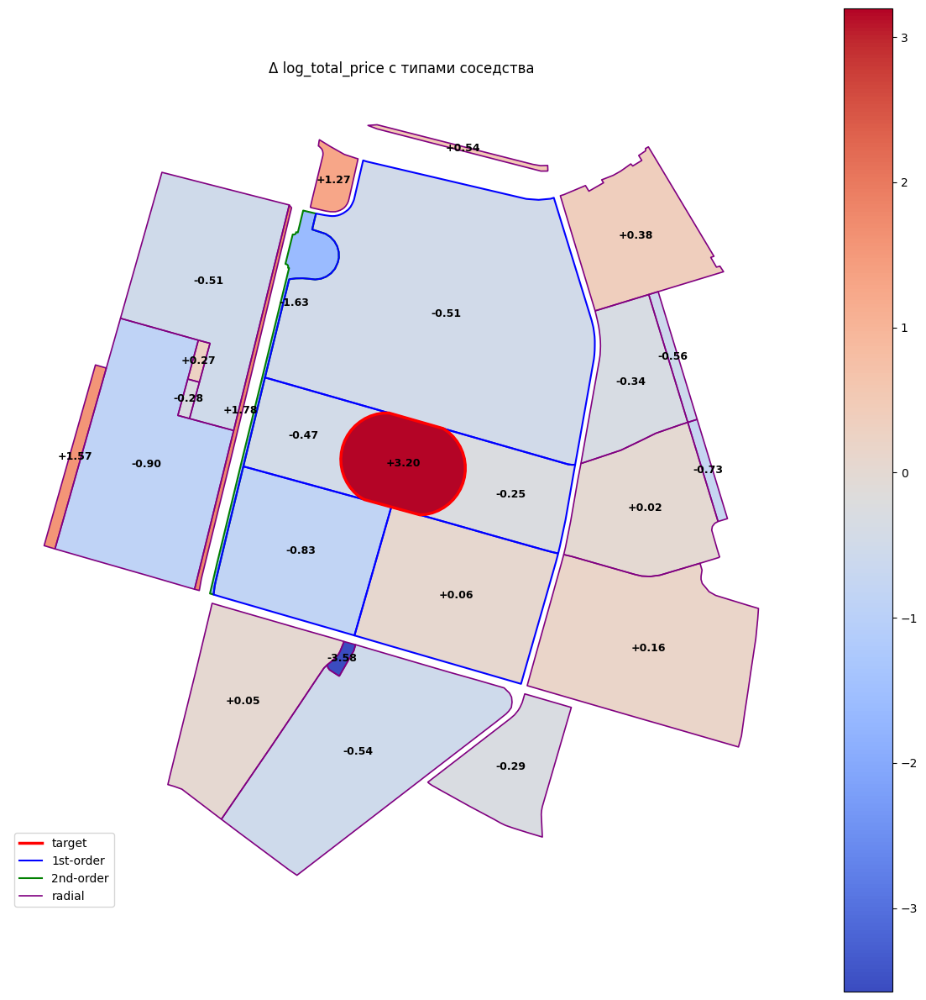

In [68]:

# === 5. Вызов функции ===
plot_scenario_with_types_highlight_target(
    blocks=blocks,
    w1=w1, w2=w2, wR=wR,
    model=model,               # ваша обученная CatBoostRegressor
    orig_feats=feature_cols,
    numeric_feats=numeric_feats,
    target_idx=4373,           # убедитесь, что такой индекс есть в blocks.index
    changes={ 'land_use':'commercial'}
)


In [60]:
blocks['id'] = blocks.index
blocks2 = blocks[['id', 'geometry']].copy()
blocks2.explore()

In [58]:
blocks

,geometry,land_use,is_living,build_floor_area,living_demand,living_area,share_living,business_area,share_business,site_area,...,lag1_degree_centrality_normalized,lag2_degree_centrality_normalized,lagR_degree_centrality_normalized,lag1_population_centrality,lag2_population_centrality,lagR_population_centrality,n1,n2,nR,id
0,"POLYGON ((354918.622 6625258.829, 354901.464 6...",None,True,"43,840.69",50.64,"30,688.48",2.20,"13,152.21",0.94,"804,466.71",...,1.16,1.18,0.00,0.10,0.10,0.00,7,23,0,0
1,"POLYGON ((355412.142 6623378.149, 355411.7 662...",transport,True,"10,294.40",53.11,"2,177.69",0.43,"8,116.71",1.61,"23,173.13",...,1.17,1.17,1.13,0.09,0.10,0.07,10,24,17,1
2,"POLYGON ((353934.329 6625429.433, 353923.453 6...",recreation,True,"1,173.87",58.69,821.71,0.71,352.16,0.30,"363,005.82",...,1.15,1.17,1.13,0.09,0.10,0.06,8,15,3,2
3,"POLYGON ((355099.099 6623847.765, 355074.808 6...",residential,True,"46,303.95",52.66,"30,595.49",2.76,"15,708.47",1.42,"196,414.47",...,1.17,1.17,1.13,0.10,0.09,0.07,8,24,5,3
4,"POLYGON ((352766.168 6621954.748, 352744.412 6...",recreation,True,"153,749.57",53.10,"106,407.75",2.35,"47,341.82",1.05,"1,781,751.56",...,1.15,1.19,0.00,0.08,0.10,0.00,16,29,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10381,"POLYGON ((335210.252 6655823.328, 335105.217 6...",transport,False,0.00,NaN,0.00,NaN,0.00,NaN,"6,477.73",...,1.13,1.20,1.12,0.07,0.10,0.06,2,7,1,10381
10382,"POLYGON ((315582.435 6679561.357, 315523.467 6...",transport,False,0.00,NaN,0.00,NaN,0.00,NaN,"1,211.68",...,1.24,1.18,1.13,0.12,0.09,0.06,4,25,2,10382
10383,"POLYGON ((316419.909 6679189.653, 316319.749 6...",transport,False,0.00,NaN,0.00,NaN,0.00,NaN,"18,351.90",...,1.20,1.19,1.16,0.10,0.10,0.08,5,22,6,10383
10384,"POLYGON ((315709.232 6679519.841, 315748.877 6...",transport,False,0.00,NaN,0.00,NaN,0.00,NaN,"1,592.31",...,1.17,1.25,1.09,0.08,0.12,0.05,4,13,1,10384
